In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

#import feather

from collections import deque

In [2]:
# set figure size to larger

plt.rcParams["figure.figsize"] = (16,8)

In [3]:
## preamble:

## the model is blind to the future and only knows the current state of the system
## based on past experience and the input state (sun, electricity price, consumption, time based features)
## the Energy Management tries to figure out the correct action to maximize
## the reward in the end (lowest cost for electricity per day)

## explaination: although the weather data and electricity price as well as consumption
## could be forcasted (or forcasted data imported), especially the price
## of the intra-day electricity price and sun irradiance are volatile and
## a model that learns to cope with this volatility would be useful in real life,
## where the forecasts are available yet often unreliable.

## one day is considered an "episode"

## The calculation of prices for buying and selling electricity from and to the grid are simplified 
## and roughly inspired by the thesis [https://www.diva-portal.org/smash/get/diva2:946072/FULLTEXT01.pdf].
## In general terms: they are tied to the spotmarket prices with a fixed factor for taxes and grid fees where
## selling electricity to the grid gains roughly half of the price that is to be paid for electricity bought from the grid.



## if that approach doesn't work:
## try to work with forecasted data and optimize for each episode (day or more)
## in advance (by algorithm or NN)

In [ ]:
# ◯◯◯ ✓✓✓

In [4]:
### imports

### import data:
# ✓ sun irradiation (global and direct)
# ✓ spot market prices electricity
# ✓ load profile household (family)

### write constructs (refine later):
# ✓ class: solar system
# ✓ class: storage
# ✓ class: energy_management

### get basic simulation of pv system running (simple storage strategy)
# ✓ create pv system and run simulation
# ✓ with logging data for each time step
# ◯ with plotting logged data after simulation


### questions: 
# ✓ time resolution of data imports? --> variable with resample, start with 15 minutes
# ◯ extra class for the simulation or just loops?


In [3]:
### GLOBALS

# time base in hours

timebase = 0.25

# create resample code string for resample function

time_str = str(timebase) + 'H'

# factors for electricity price buy and sell based on spotmarket price

factor_buy = 10
factor_sell = 5

In [4]:
### electricity consumption data import

# read power consumption data (3-phases in seperate files)

df1 = pd.read_csv('./data/CSV_74_Loadprofiles_1min_W_var/PL1.csv', header=None)
df2 = pd.read_csv('./data/CSV_74_Loadprofiles_1min_W_var/PL2.csv', header=None)
df3 = pd.read_csv('./data/CSV_74_Loadprofiles_1min_W_var/PL3.csv', header=None)

In [5]:
# only keep 10 households and add all 3 phases together

df1 = df1.loc[:,0:9]
df2 = df2.loc[:,0:9]
df3 = df3.loc[:,0:9]

data = df1 + df2 + df3

# add prefix

electricity = data.add_suffix(' Electricity consumption [W]')

# read respective timestamps in separate file

#ts = pd.read_csv('./data/CSV_74_Loadprofiles_1min_W_var/time_datevec_MEZ.csv', header=None)

#ts.columns = ['year', 'month', 'day', 'hour', 'minute', 'second']
#ts.drop(['second', 'minute', 'year'], axis=1, inplace=True)

# concatenate electricity data with timestamps

# electricity = pd.concat([ts, data], axis=1)

# create datetime index and move data into the year 2020

# 2010.01.01 is a friday, 2020.01.01 is a wednesday
# we want to "port" the consumption data into the year 2020. To align the weekdays correctly, we have to move it 2 days into the future
# the timestamp range for the consumption data therefore starts at the 3rd of Jan (2020), which is the closest friday.

index = pd.date_range(start='2020-01-03 00:00:00', freq='min', periods=len(electricity))

# set datetime index as df index

electricity.index = index

# resample to timebase

electricity = electricity.resample(time_str).interpolate('time')

# cut to end of 2020

electricity = electricity[electricity.index.year == 2020]

In [6]:
electricity

,0 Electricity consumption [W],1 Electricity consumption [W],2 Electricity consumption [W],3 Electricity consumption [W],4 Electricity consumption [W],5 Electricity consumption [W],6 Electricity consumption [W],7 Electricity consumption [W],8 Electricity consumption [W],9 Electricity consumption [W]
2020-01-03 00:00:00,95,501,403,61,357,57,289,738,642,1254
2020-01-03 00:15:00,131,206,65,217,168,43,456,330,241,230
2020-01-03 00:30:00,133,121,289,153,288,74,508,478,271,203
2020-01-03 00:45:00,141,191,232,92,176,42,326,382,254,271
2020-01-03 01:00:00,199,215,527,95,160,69,618,1876,305,192
...,...,...,...,...,...,...,...,...,...,...
2020-12-31 22:45:00,403,476,899,233,199,271,110,578,42,777
2020-12-31 23:00:00,299,491,2007,75,120,263,203,508,79,666
2020-12-31 23:15:00,462,484,1277,81,119,192,121,641,140,464
2020-12-31 23:30:00,167,515,972,119,110,301,131,635,42,617


In [7]:
electricity.mean()

0 Electricity consumption [W]    370.627318
1 Electricity consumption [W]    514.209592
2 Electricity consumption [W]    753.694797
3 Electricity consumption [W]    305.792096
4 Electricity consumption [W]    364.798535
5 Electricity consumption [W]    158.620765
6 Electricity consumption [W]    335.602850
7 Electricity consumption [W]    592.529562
8 Electricity consumption [W]    915.930002
9 Electricity consumption [W]    381.952324
dtype: float64

<AxesSubplot:>

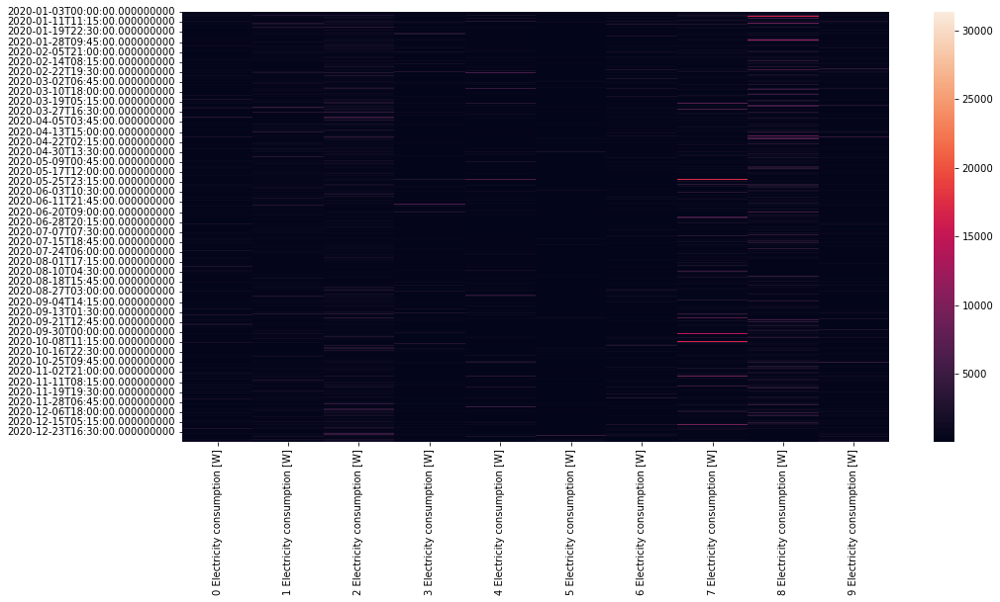

In [8]:
sns.heatmap(electricity)

In [11]:
# electricity consumption in Watts

px.line(data_frame=electricity, x=electricity.index, y='0 Electricity consumption [W]')

In [9]:
### sun irradiance data import

df = pd.read_csv('./data/produkt_zehn_min_sd_20200101_20211231_01048.txt', sep=';', parse_dates=['MESS_DATUM'])
df = df[['MESS_DATUM', 'GS_10']]

# set missing values to NaN

df['GS_10'] = df['GS_10'].replace(-999.0, np.NaN)

# impute Nan values with forward fill

df = df.ffill(axis=0)

# set index to datetime column

df.set_index('MESS_DATUM', inplace=True)


# convert from J/cm² to W/m² (with 10 min timebase):
# 1 J = 1 Ws --> 1 Ws/cm² in 10 minutes (600 sec) = 1/600 W/cm² = 10.000/600 W/m² = 16,67 W/m²
# check: max values in data are ~ 60 J/cm² in summer which converts to around 1000 W/m² which is a realistic value

df['GS'] = df['GS_10'] * 16.6667
df.drop('GS_10', axis=1, inplace=True)

# after converting from energy to power (removing the integral), we can now resample the data to the global timebase

df = df.resample(time_str).interpolate('time')

# cut length to match electricity data (not the same year!)

sun_data = df.loc[(df.index >= electricity.index[0]) & (df.index <= electricity.index[-1])]

<AxesSubplot:ylabel='MESS_DATUM'>

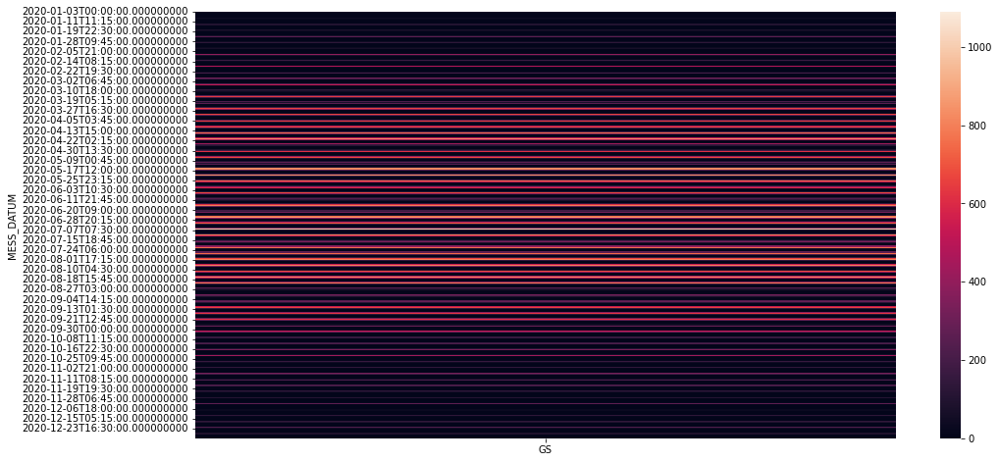

In [13]:
sns.heatmap(sun_data)

In [14]:
# sun irradiance in Watts per m²

px.line (data_frame=sun_data, x=sun_data.index, y='GS')

In [10]:
### import spot market prices

df = pd.read_csv('./data/energy-charts_Electricity_production_and_spot_prices_in_Germany_in_2020.csv')

# create dt index, bc of issues parsing it initially
index = pd.date_range(start='2020-01-01 00:00:00', freq='15min', periods=len(df))
df.index = index

# only keep data of interest 

df = df[['Day Ahead Auction (DE-LU)']]

# resample to timebase

spot_market = df.resample(time_str).interpolate('time')

# cut to length of electricity data set

spot_market = spot_market[(spot_market.index >= electricity.index[0]) & (spot_market.index <= electricity.index[-1])] 

<AxesSubplot:>

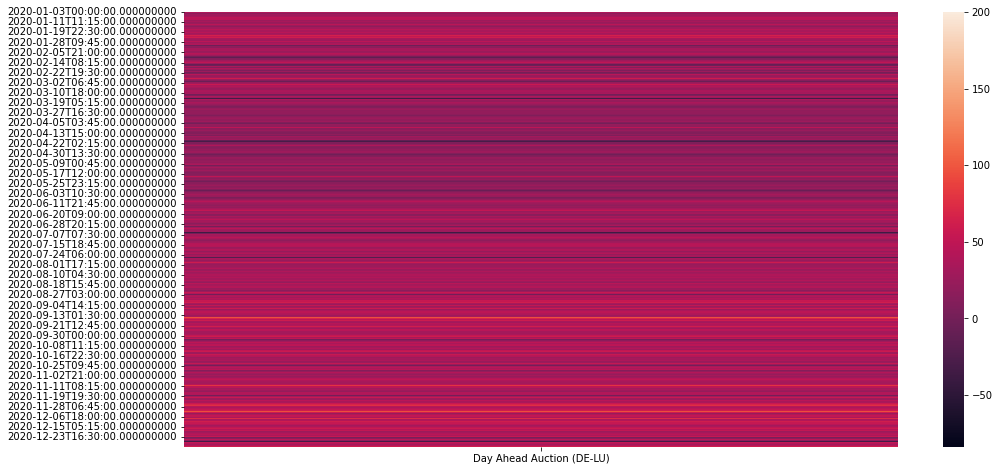

In [16]:
sns.heatmap(spot_market)

In [17]:
px.line(data_frame=spot_market, x=spot_market.index, y='Day Ahead Auction (DE-LU)')

In [11]:
### combine all datasets into one dataframe

# create time index structure according to sun_data and global timebase

df = pd.DataFrame(index=pd.date_range(start=sun_data.index[0], freq=time_str, periods=len(sun_data)))

# import columns of interest

df['Global horizontal irradiance [W/m²]'] = sun_data['GS']
df['Day Ahead Auction (DE-LU) [€/MWh]'] = spot_market['Day Ahead Auction (DE-LU)']

# concatenate with columns of interest from electricity

dataset = pd.concat([df, electricity], axis=1)

In [19]:
dataset

,Global horizontal irradiance [W/m²],Day Ahead Auction (DE-LU) [€/MWh],0 Electricity consumption [W],1 Electricity consumption [W],2 Electricity consumption [W],3 Electricity consumption [W],4 Electricity consumption [W],5 Electricity consumption [W],6 Electricity consumption [W],7 Electricity consumption [W],8 Electricity consumption [W],9 Electricity consumption [W]
2020-01-03 00:00:00,0.0,13.04,95,501,403,61,357,57,289,738,642,1254
2020-01-03 00:15:00,0.0,13.04,131,206,65,217,168,43,456,330,241,230
2020-01-03 00:30:00,0.0,13.04,133,121,289,153,288,74,508,478,271,203
2020-01-03 00:45:00,0.0,13.04,141,191,232,92,176,42,326,382,254,271
2020-01-03 01:00:00,0.0,1.53,199,215,527,95,160,69,618,1876,305,192
...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-31 22:45:00,0.0,52.26,403,476,899,233,199,271,110,578,42,777
2020-12-31 23:00:00,0.0,50.87,299,491,2007,75,120,263,203,508,79,666
2020-12-31 23:15:00,0.0,50.87,462,484,1277,81,119,192,121,641,140,464
2020-12-31 23:30:00,0.0,50.87,167,515,972,119,110,301,131,635,42,617


In [35]:
## feature enginnering:

# create time based features (month, weekday, hour)

dataset['month'] = dataset.index.month
dataset['week'] = dataset.index.isocalendar().week
dataset['weekday'] = dataset.index.weekday
dataset['hour'] = dataset.index.hour
dataset['quarter_hour'] = dataset.index.minute / 15

In [36]:
dataset.head()

,Global horizontal irradiance [W/m²],Day Ahead Auction (DE-LU) [€/MWh],0 Electricity consumption [W],1 Electricity consumption [W],2 Electricity consumption [W],3 Electricity consumption [W],4 Electricity consumption [W],5 Electricity consumption [W],6 Electricity consumption [W],7 Electricity consumption [W],8 Electricity consumption [W],9 Electricity consumption [W],month,weekday,hour,quarter_hour,week
2020-01-03 00:00:00,0.0,13.04,95,501,403,61,357,57,289,738,642,1254,1,4,0,0.0,1
2020-01-03 00:15:00,0.0,13.04,131,206,65,217,168,43,456,330,241,230,1,4,0,1.0,1
2020-01-03 00:30:00,0.0,13.04,133,121,289,153,288,74,508,478,271,203,1,4,0,2.0,1
2020-01-03 00:45:00,0.0,13.04,141,191,232,92,176,42,326,382,254,271,1,4,0,3.0,1
2020-01-03 01:00:00,0.0,1.53,199,215,527,95,160,69,618,1876,305,192,1,4,1,0.0,1


In [37]:
### safe dataset as pickle

dataset.to_pickle('./pickles/dataset.pickle')

In [22]:
######################################################################
### Simulation
######################################################################

In [23]:
### get basic simulation of pv system running (simple storage strategy)
# ✓ create pv system and run simulation
# ✓ with logging data for each time step
# ✓ with plotting logged data after simulation

In [13]:
class Energy_management:
    def __init__(self, name, strategy, timebase):
        self.name = name
        self.timebase = timebase
        self.strategy = strategy
        
        self.daily_cost = 0
        self.total_cost = 0
        self.memory = deque(maxlen=10000)
        
    def __repr__(self):
        return f"Energy Management {self.name} running on strategy {self.strategy}."
    
    def get_state(self):
        ## get pv_power thats available, demand by consumer,
        ## state of the storage and the current price of electricity
        pass
    
    def get_action(self):
        ## derive action for this state depending on strategy
        pass
    
    def act(self, action):
        ## do action, calculate reward
        ## return reward
        pass
    
    def remember(self):
        ## store state, action, reward, new_state
        pass
    
    def backpropagate(self):
        ## apply bellman equation to backpropagate rewards through time
        pass
    
    def replay(self):
        ## draw minibatches from memory (with timesteps for lstm approach)
        ## only draw up to last episode that has been backpropagated
        pass
    
    def create_model(self):
        ## create model with state_space input shape and
        ## action space output shape
        ## depending on 
        pass
    
    def train_model(self, episodes):
        ## go through episodes (days) and act and remember etc.
        ## after each step, try to replay()
        ## after each episode, store the sum of rewards (score)
        pass

In [14]:
# simplification: solar system is in horizontal orientation, therefore global horizontal irradiance can be used directly

class PV_system:
    def __init__(self, name, nom_power, nom_eff):
        self.name = name
        self.nom_power = nom_power
        self.nom_eff = nom_eff
        #self.tilt = elevation
        #self.azimuth = azimuth
        
        self.power = 0
    
    def __repr__(self):
        return f"Solar System {self.name} is generating {self.power} kW."
    
    def calc(self, glob_horiz):
        ## output power
        self.power = glob_horiz / 1000 * self.nom_power

        return self.power
        

In [15]:
class Storage:
    def __init__(self, name, nom_capacity, nom_power, roundtrip_eff, timebase):
        self.name = name
        self.nom_capacity = nom_capacity
        self.nom_power = nom_power
        self.roundtrip_eff = roundtrip_eff
        self.timebase = timebase
        
        self.power = 0
        self.state_of_charge = 0
        
    def __repr__(self):
        return f"Storage {self.name} is delivering {self.power} kW and SOC is {self.state_of_charge}."

    def calc(self, power_request):
        ## calculate drawn power, energy and new state of charge
        if power_request >= 0:
            # discharging:
            # calc max discharging power for state-of-charge and timebase (SOC cannot go below 0)
            max_power_discharge = np.min((self.nom_power, self.state_of_charge * self.nom_capacity / self.timebase))
            self.power = np.min((max_power_discharge, power_request))
            self.state_of_charge -= self.power * self.timebase / self.nom_capacity
        else:
            # charging (power request is negative)
            # calc max charging power for state of charge and timebase (SOC not exceeding 100 %)
            max_power_charge = np.min((self.nom_power, (1 - self.state_of_charge) * self.nom_capacity / self.timebase))
            # charging power must be smaller than nom_power
            self.power = (-1) * np.min((max_power_charge, np.abs(power_request)))
            self.state_of_charge += np.abs(self.power) * self.roundtrip_eff * self.timebase / self.nom_capacity
        return self.power, self.state_of_charge

In [22]:
class Simulation:
    def __init__(self, name, consumer, pv_system, storage, energy_management, dataset, timebase):
        self.name = name
        self.consumer = consumer
        self.pv_system = pv_system
        self.storage = storage
        self.energy_management = energy_management
        self.timebase = timebase
        self.dataset = dataset
        
    def __repr__(self):
        return f"Simulation {self.name} for consumer {self.consumer} initialized with timebase {self.timebase} h."
    
    def run(self, start, stop):
        #global factor_buy
        #global factor_sell
        # list for simulation output
        results = []
        accumulated_system_balance = 0
        accumulated_reward = 0
        
        # extract dataset from start to stop
        span = pd.date_range(start=start, end=stop, periods=2)
        dataset = self.dataset[(self.dataset.index >= span[0]) & (self.dataset.index <= span[1])]
        
        # main loop
        for index, row in dataset.iterrows():
            
            # read values from row
            spotprice = row['Day Ahead Auction (DE-LU) [€/MWh]']
            demand = row[(str(self.consumer) + ' Electricity consumption [W]')]
            solar_irr = row['Global horizontal irradiance [W/m²]']

            # calc buy and sell prices in €/Wh (spotmarket price is in €/MWh)
            sellprice = spotprice * factor_sell * 1e-6
            buyprice = spotprice * factor_buy * 1e-6
            
            # power balance with only PV
            solar_power = self.pv_system.calc(solar_irr)
            solar_balance = demand - solar_power
            
            # system balance (including storage) is negative when power is drawn from the grid and positive when fed in
            storage_power, _ = self.storage.calc(solar_balance)
            system_balance = storage_power - solar_balance
            
            # check if selling or buying to/from grid
            if system_balance <= 0:
                reward = system_balance * timebase * buyprice
            else:
                reward = system_balance * timebase * sellprice
            
            # accumulate system_balance and reward
            accumulated_system_balance += system_balance * timebase
            accumulated_reward += reward
            
            # store results
            results.append([index, demand, solar_power, solar_balance, storage_power, self.storage.state_of_charge, system_balance, reward, accumulated_reward])
        
        return results, accumulated_system_balance, accumulated_reward        
        

In [23]:
### Test simulation to verify that all values make some sense

energy_m = Energy_management(name='EM1', strategy='simple', timebase=timebase)
pv = PV_system(name='PV1', nom_power=5000, nom_eff=0.2)
storage = Storage(name='ST1', nom_capacity=5000, nom_power=3000, roundtrip_eff=0.9, timebase=timebase)
sim = Simulation(name='SIM1', consumer=0, pv_system=pv, storage=storage, energy_management=energy_m, dataset=dataset, timebase=timebase)

pv, energy_m, storage, sim

(Solar System PV1 is generating 0 kW.,
 Energy Management EM1 running on strategy simple.,
 Storage ST1 is delivering 0 kW and SOC is 0.,
 Simulation SIM1 for consumer 0 initialized with timebase 0.25 h.)

In [24]:
# run simulation

results, asb, ar = sim.run(start='2020-01-01 00:00:00', stop='2020-12-31 23:45:00')

In [28]:
# accumulated grid balance, accumulated reward (electricity cost)

asb, ar

(2453551.674444966, 15.91357729532241)

In [30]:
### print results in a nice px graph

# convert list of results into df

df = pd.DataFrame(results, columns=['datetime', 'consumption', 'PV_power', 'ST_request', 'ST_power', 'ST_SOC', 'grid_power', 'reward', 'acc_reward'])
df.set_index('datetime', inplace=True)

# ✓ see if results are sensible

# ✓ make plot

from plotly.subplots import make_subplots

fig = make_subplots(specs=[[{"secondary_y": True}]])

fig.add_traces(
    list(px.line(data_frame=df.drop(['ST_SOC', 'acc_reward'], axis=1)).select_traces()),
    secondary_ys=[False]
)

fig.add_traces(
    list(px.line(data_frame=df[['ST_SOC', 'reward']]).select_traces()),
    secondary_ys=[True, True]
)

fig.update_yaxes(range=[-2,2], secondary_y=True)

fig.show()